In [7]:
from __future__ import print_function
from __future__ import division
import torch
import torch.nn as nn
import torch.optim as optim
import numpy as np
import torchvision
from torchvision import datasets, models, transforms
import matplotlib.pyplot as plt
import time
import os
import copy

print("PyTorch Version: ",torch.__version__)
print("Torchvision Version: ",torchvision.__version__)

PyTorch Version:  1.13.1
Torchvision Version:  0.14.1


In [8]:
data_dir = "/media/abdul/8266fdc5-61f6-47d6-9e82-aa0e56f4b319/Ilyas/Gender/pets classification/Pet_Breeds"
num_classes = 23
batch_size = 32
num_epochs = 10
model = models.mobilenet_v2(pretrained=True)
# Update model output size to 2.
model.classifier = nn.Linear(1280, num_classes)
model

MobileNetV2(
  (features): Sequential(
    (0): Conv2dNormActivation(
      (0): Conv2d(3, 32, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU6(inplace=True)
    )
    (1): InvertedResidual(
      (conv): Sequential(
        (0): Conv2dNormActivation(
          (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=32, bias=False)
          (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (2): ReLU6(inplace=True)
        )
        (1): Conv2d(32, 16, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (2): BatchNorm2d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      )
    )
    (2): InvertedResidual(
      (conv): Sequential(
        (0): Conv2dNormActivation(
          (0): Conv2d(16, 96, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (1): BatchNorm2d(96, eps=

In [9]:
def train_model(model, dataloaders, criterion, optimizer, num_epochs=25):
    
    since = time.time()

    val_acc_history = []

    best_model_wts = copy.deepcopy(model.state_dict())
    best_acc = 0.0

    for epoch in range(num_epochs):
       # print('Epoch {}/{}'.format(epoch, num_epochs - 1))
        print('-' * 10)

        # Each epoch has a training and validation phase
        for phase in ['train', 'val']:
            if phase == 'train':
                model.train()  # Set model to training mode
            else:
                model.eval()   # Set model to evaluate mode

            running_loss = 0.0
            running_corrects = 0

            # Iterate over data.
            for inputs, labels in dataloaders[phase]:
                inputs = inputs.to(device)
                labels = labels.to(device)

                # zero the parameter gradients
                optimizer.zero_grad()

                # forward
                # track history if only in train
                with torch.set_grad_enabled(phase == 'train'):
                    if phase == 'train':
                
                        outputs = model(inputs)
                        loss = criterion(outputs, labels)
                        
                    else:
                        outputs = model(inputs)
                        loss = criterion(outputs, labels)

                    _, preds = torch.max(outputs, 1)

                    # backward + optimize only if in training phase
                    if phase == 'train':
                        loss.backward()
                        optimizer.step()

                # statistics
                running_loss += loss.item() * inputs.size(0)
                running_corrects += torch.sum(preds == labels.data)

            epoch_loss = running_loss / len(dataloaders[phase].dataset)
            epoch_acc = running_corrects.double() / len(dataloaders[phase].dataset)

            print('{} Loss: {:.4f} Acc: {:.4f}'.format(phase, epoch_loss, epoch_acc))

            # deep copy the model
            if phase == 'val' and epoch_acc > best_acc:
                best_acc = epoch_acc
                best_model_wts = copy.deepcopy(model.state_dict())
            if phase == 'val':
                val_acc_history.append(epoch_acc)

        print()

    time_elapsed = time.time() - since
    print('Training complete in {:.0f}m {:.0f}s'.format(time_elapsed // 60, time_elapsed % 60))
    print('Best val Acc: {:4f}'.format(best_acc))

    # load best model weights
    model.load_state_dict(best_model_wts)
    return model, val_acc_history

def set_parameter_requires_grad(model, feature_extracting):
    if feature_extracting:
        for param in model.parameters():
            param.requires_grad = False

In [10]:
# Data augmentation and normalization for training
# Just normalization for validation
data_transforms = {
    'train': transforms.Compose([
        transforms.Resize((224,224)),
        transforms.RandomHorizontalFlip(),
        transforms.ToTensor(),
        #transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
    ]),
    'val': transforms.Compose([
        transforms.Resize((224,224)),
        #transforms.CenterCrop(224),
        transforms.ToTensor(),
        #transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
    ]),
}

print("Initializing Datasets and Dataloaders...")

# Create training and validation datasets
image_datasets = {x: datasets.ImageFolder(os.path.join(data_dir, x), data_transforms[x]) for x in ['train', 'val']}
# Create training and validation dataloaders
dataloaders_dict = {x: torch.utils.data.DataLoader(image_datasets[x], batch_size=batch_size, shuffle=True, num_workers=4) for x in ['train', 'val']}

# Detect if we have a GPU available
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")



Initializing Datasets and Dataloaders...


In [11]:
train_dataset_size = len(image_datasets['train'])
val_dataset_size = len(image_datasets['val'])

print("Number of training samples: ", train_dataset_size)
print("Number of validation samples: ", val_dataset_size)

Number of training samples:  3766
Number of validation samples:  115


In [5]:
# for i, data in enumerate(dataloaders_dict['train'], 0):
#         # get the inputs; data is a list of [inputs, labels]
#         inputs, labels = data[0].to(device), data[1].to(device)
#         print(inputs.size())


In [6]:
model_ft = model.to(device)

params_to_update = []

for name, param in model_ft.named_parameters():
    param.requires_grad == False
    

for name,param in model_ft.named_parameters():

    if 'features.17' in name:
        param.requires_grad == True
        params_to_update.append(param)        

    if 'features.18' in name:
        param.requires_grad == True
        params_to_update.append(param)
        
    if 'classifier' in name:
        param.requires_grad == True
        params_to_update.append(param)
        

In [7]:
optimizer_ft = optim.SGD(params_to_update, lr=0.0005, momentum=0.9)

criterion = nn.CrossEntropyLoss()

model_ft, hist = train_model(model_ft, 
                             dataloaders_dict, 
                             criterion, 
                             optimizer_ft, 
                             num_epochs=25)

----------
train Loss: 2.2957 Acc: 0.5109
val Loss: 1.4159 Acc: 0.7913

----------
train Loss: 1.1885 Acc: 0.8099
val Loss: 0.8218 Acc: 0.8870

----------
train Loss: 0.8147 Acc: 0.8420
val Loss: 0.6108 Acc: 0.9043

----------
train Loss: 0.6624 Acc: 0.8574
val Loss: 0.5122 Acc: 0.8957

----------
train Loss: 0.5797 Acc: 0.8731
val Loss: 0.4606 Acc: 0.9043

----------
train Loss: 0.5151 Acc: 0.8848
val Loss: 0.4234 Acc: 0.9217

----------
train Loss: 0.4758 Acc: 0.8885
val Loss: 0.4015 Acc: 0.9217

----------
train Loss: 0.4393 Acc: 0.8948
val Loss: 0.3848 Acc: 0.9217

----------
train Loss: 0.4054 Acc: 0.9110
val Loss: 0.3751 Acc: 0.9217

----------
train Loss: 0.3855 Acc: 0.9087
val Loss: 0.3600 Acc: 0.9130

----------
train Loss: 0.3628 Acc: 0.9118
val Loss: 0.3523 Acc: 0.9217

----------
train Loss: 0.3523 Acc: 0.9166
val Loss: 0.3431 Acc: 0.9217

----------
train Loss: 0.3394 Acc: 0.9140
val Loss: 0.3336 Acc: 0.9217

----------
train Loss: 0.3136 Acc: 0.9238
val Loss: 0.3421 Acc: 

In [8]:
img_test_transforms = transforms.Compose([
    transforms.Resize((224,224)),
        #transforms.CenterCrop(224),
        transforms.ToTensor(),
        #transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
    ])

test_data = torchvision.datasets.ImageFolder(data_dir + '/val',transform=img_test_transforms)
test_loader = torch.utils.data.DataLoader(test_data, batch_size=batch_size, 
                                          shuffle=False, num_workers=4)

In [9]:
model_ft.eval()  # it-disables-dropout
with torch.no_grad():
    correct = 0
    total = 0
    for images, labels in test_loader:
       
        images = images.to(device)
        labels = labels.to(device)
        outputs = model_ft(images)
        _, predicted = torch.max(outputs.data, 1)
        total += labels.size(0)
        print("input",labels)
        print("output",predicted)
        
        correct += (predicted == labels).sum().item()
          
    print('Test Accuracy of the model: {} %'.format(100 * correct / total))
    print('correct: {:d}  total: {:d}'.format(correct, total))


input tensor([0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 2, 2, 2, 2, 2, 3, 3, 3, 3, 3, 4, 4, 4, 4,
        4, 5, 5, 5, 5, 5, 6, 6], device='cuda:0')
output tensor([ 0,  0,  0,  0,  0,  1,  1,  1,  1,  1,  2,  2,  2,  2,  2,  3,  3,  3,
         3,  3,  4,  4,  4,  4,  4,  5, 14,  5,  5,  5,  6,  6],
       device='cuda:0')
input tensor([ 6,  6,  6,  7,  7,  7,  7,  7,  8,  8,  8,  8,  8,  9,  9,  9,  9,  9,
        10, 10, 10, 10, 10, 11, 11, 11, 11, 11, 12, 12, 12, 12],
       device='cuda:0')
output tensor([ 6,  6,  6,  7,  7,  7,  9,  7,  8,  8,  8,  6,  7,  9,  9,  9,  9,  9,
        10, 10, 10, 10, 10, 11, 11, 11, 11, 11, 12, 12, 12, 12],
       device='cuda:0')
input tensor([12, 13, 13, 13, 13, 13, 14, 14, 14, 14, 14, 15, 15, 15, 15, 15, 16, 16,
        16, 16, 16, 17, 17, 17, 17, 17, 18, 18, 18, 18, 18, 19],
       device='cuda:0')
output tensor([12, 13, 13, 13, 13, 13, 14, 14, 14, 14, 12, 15, 15, 15, 15, 15, 16, 16,
        16, 16, 16, 17, 17,  1, 17, 17, 18, 18, 18, 18, 18, 19],
       dev

In [12]:
from PIL import Image
import matplotlib.pyplot as plt
%matplotlib inline

classes = ['abyssinian', 'american shorthair','beagle','boxer','bulldog','chihuahua','corgi','dachshund',
           'german shepherd','golden retriever','husky',
          'labrador','maine coon','mumbai cat','persian cat','pomeranian','pug','ragdoll cat',
           'rottwiler','shiba inu',
          'siamese cat','sphynx','yorkshire terrier']

loader = transforms.Compose([transforms.Resize((224,224)),
                             transforms.ToTensor(), 
                              #normalize
                            ])

def image_loader(image_name):

    image = Image.open(image_name)
    image = image.convert('RGB')
    image = loader(image)
    image = image.unsqueeze(0)  
    image = image.cuda()
    return image  #assumes that you're using GPU

model = model_ft
model.eval()
image = image_loader('/media/abdul/8266fdc5-61f6-47d6-9e82-aa0e56f4b319/Ilyas/Gender/Pet_Breeds/val/abyssinian/abyssinian_5.jpg')
pred = (model(image)).data.cpu().numpy().argmax()

print('Prediction: ', pred)
print('Class: ', classes[pred])

Prediction:  0
Class:  abyssinian


In [13]:


from PIL import Image
import matplotlib.pyplot as plt
%matplotlib inline

classes = ['abyssinian', 'american shorthair','beagle','boxer','bulldog','chihuahua','corgi','dachshund',
           'german shepherd','golden retriever','husky',
          'labrador','maine coon','mumbai cat','persian cat','pomeranian','pug','ragdoll cat',
           'rottwiler','shiba inu',
          'siamese cat','sphynx','yorkshire terrier']

loader = transforms.Compose([transforms.Resize((224,224)),
                             transforms.ToTensor(), 
                              #normalize
                            ])

def image_loader(image_name):

    image = Image.open(image_name)
    image = image.convert('RGB')
    image = loader(image)
    image = image.unsqueeze(0)  
    image = image.cuda()
    return image  #assumes that you're using GPU

model = model_ft
model.eval()
image = image_loader('/media/abdul/8266fdc5-61f6-47d6-9e82-aa0e56f4b319/Ilyas/Gender/Pet_Breeds/val/maine coon/maine coon_3.jpg')
pred = (model(image)).data.cpu().numpy().argmax()

print('Prediction: ', pred)
print('Class: ', classes[pred])

Prediction:  12
Class:  maine coon


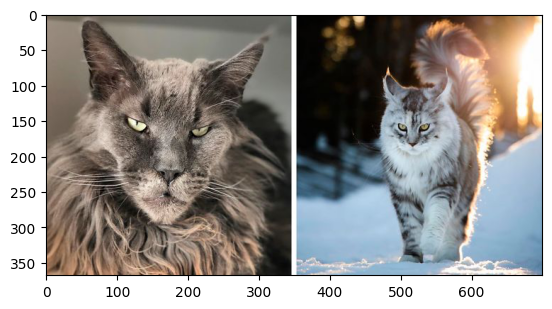

In [14]:
def imshow(img):
    img = Image.open(img)
    plt.imshow(img)  
    
imshow('/media/abdul/8266fdc5-61f6-47d6-9e82-aa0e56f4b319/Ilyas/Gender/Pet_Breeds/val/maine coon/maine coon_3.jpg')

In [15]:
import glob
images = []
for f in glob.iglob("/media/abdul/8266fdc5-61f6-47d6-9e82-aa0e56f4b319/Ilyas/Gender/Pet_Breeds/val/*/*"):
    images.append(f)

Prediction:  22    Class:  yorkshire terrier


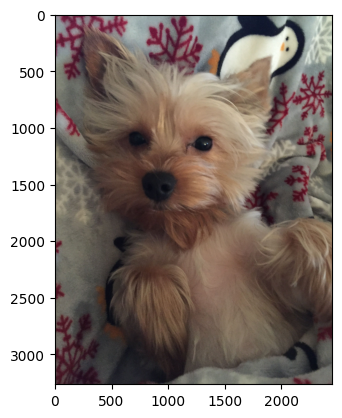

Prediction:  22    Class:  yorkshire terrier


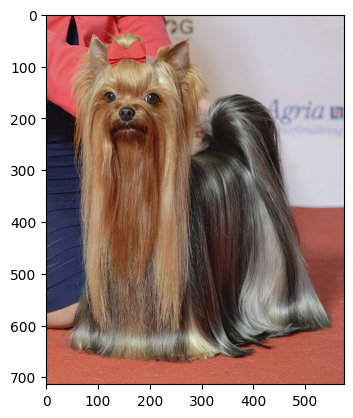

Prediction:  22    Class:  yorkshire terrier


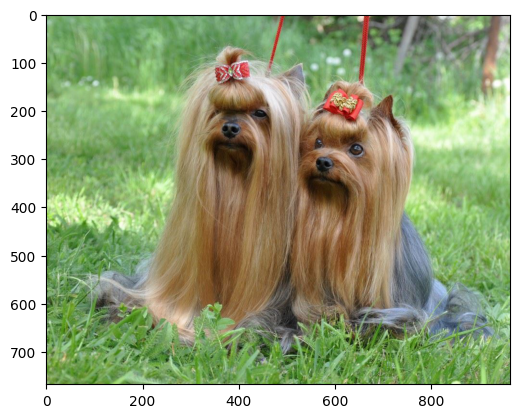

Prediction:  22    Class:  yorkshire terrier


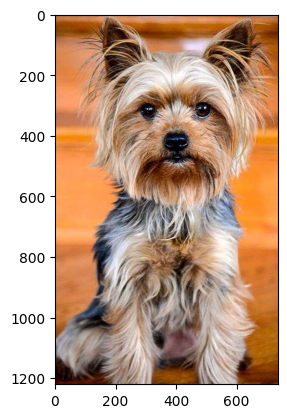

Prediction:  22    Class:  yorkshire terrier


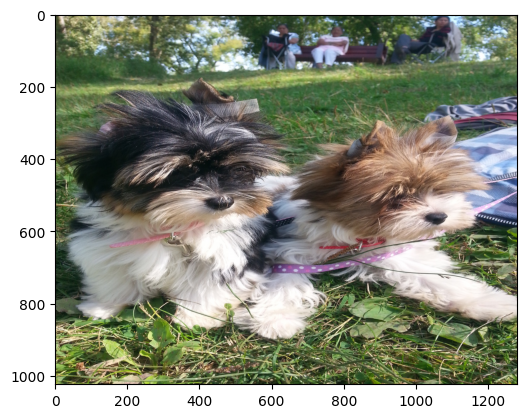

Prediction:  17    Class:  ragdoll cat


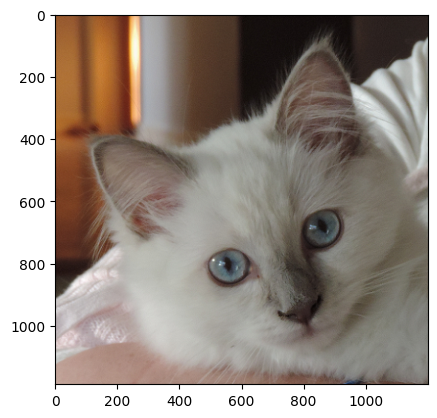

Prediction:  17    Class:  ragdoll cat


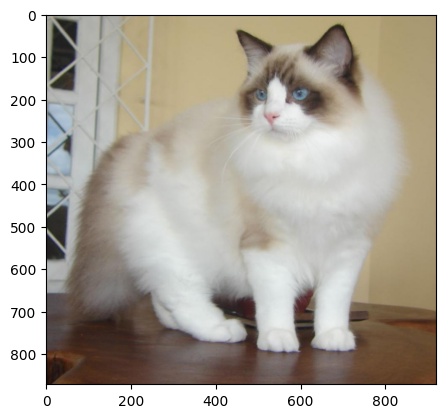

Prediction:  17    Class:  ragdoll cat


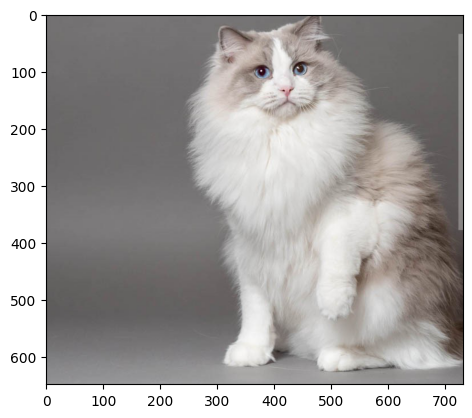

Prediction:  1    Class:  american shorthair


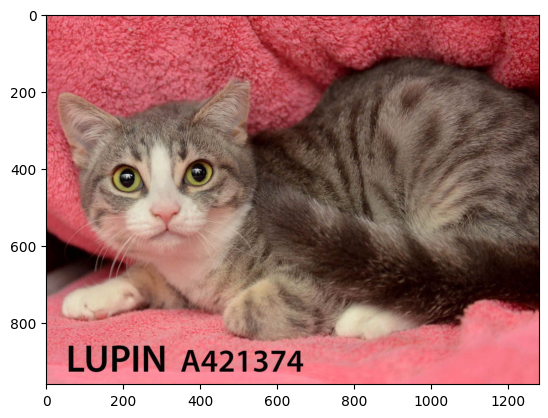

Prediction:  17    Class:  ragdoll cat


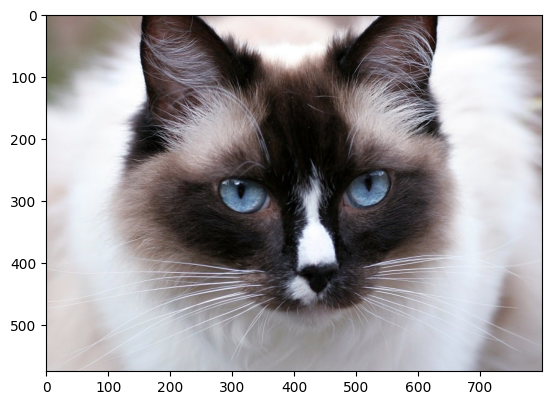

Prediction:  19    Class:  shiba inu


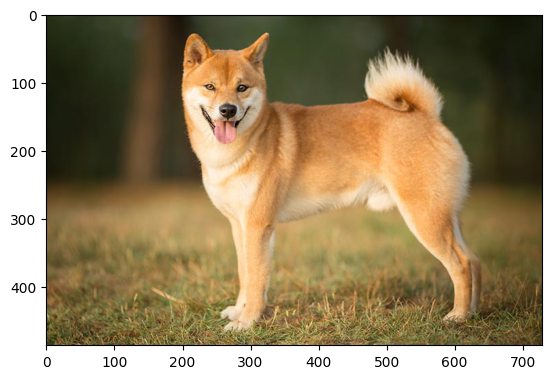

Prediction:  19    Class:  shiba inu


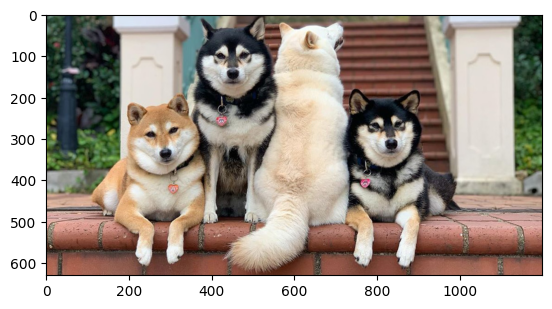

Prediction:  10    Class:  husky


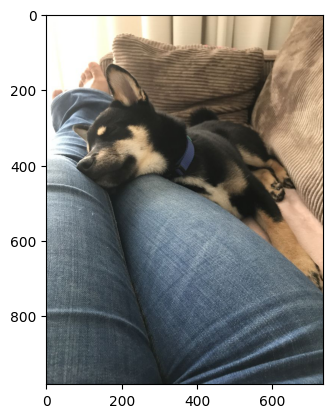

Prediction:  19    Class:  shiba inu


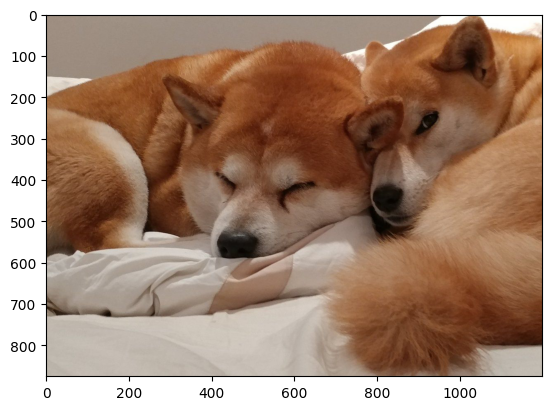

Prediction:  19    Class:  shiba inu


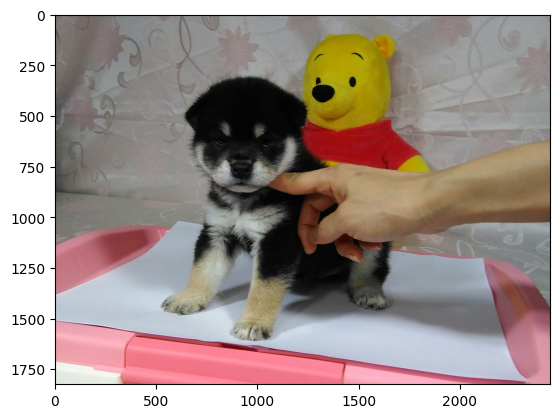

Prediction:  15    Class:  pomeranian


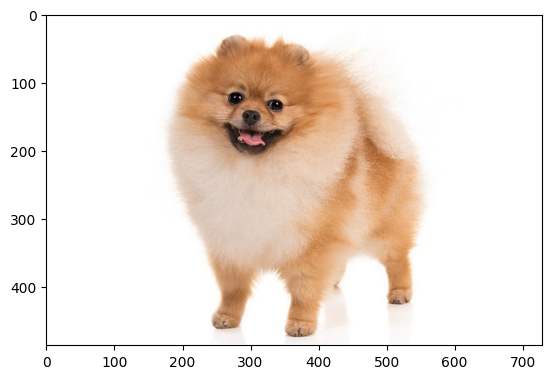

Prediction:  15    Class:  pomeranian


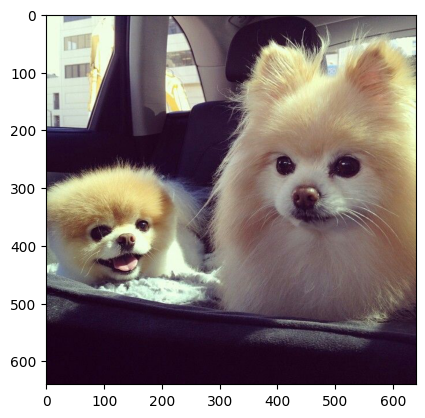

Prediction:  15    Class:  pomeranian


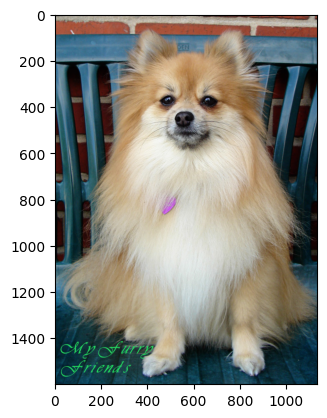

Prediction:  15    Class:  pomeranian


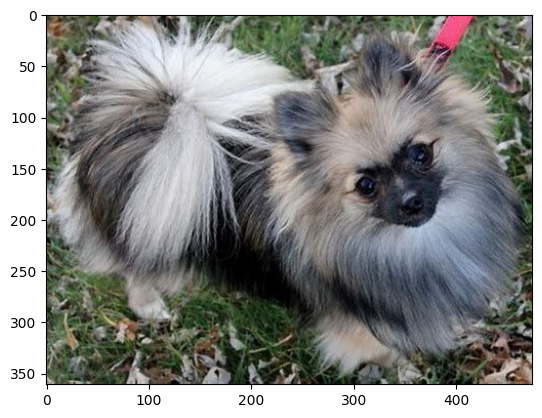

Prediction:  15    Class:  pomeranian


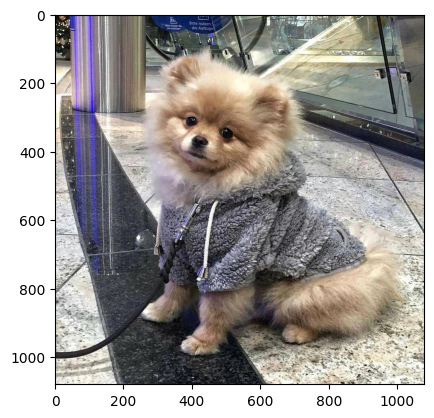

Prediction:  0    Class:  abyssinian


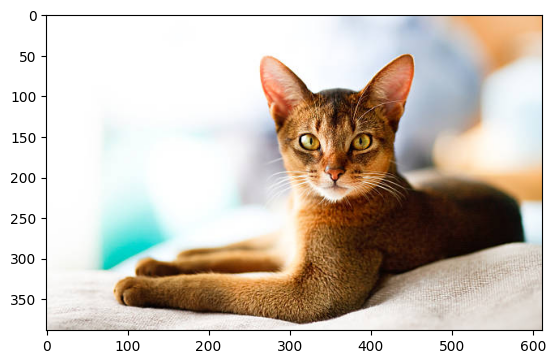

Prediction:  0    Class:  abyssinian


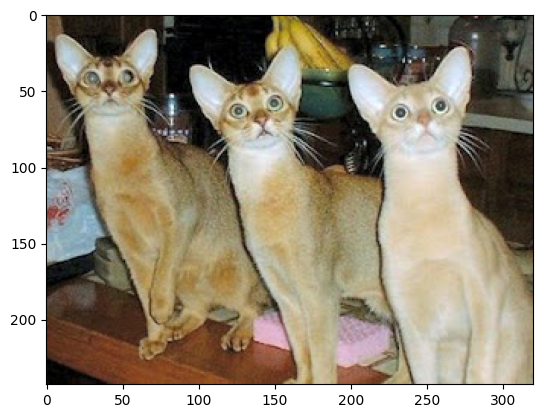

Prediction:  0    Class:  abyssinian


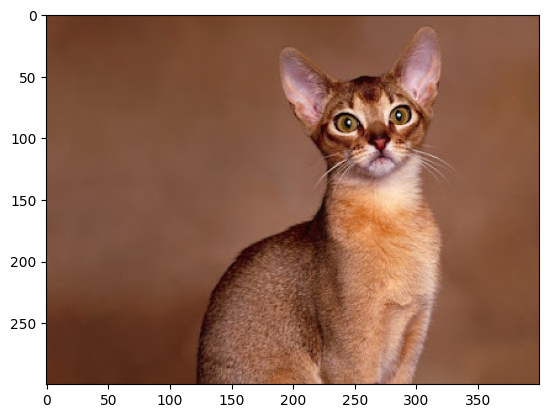

Prediction:  0    Class:  abyssinian


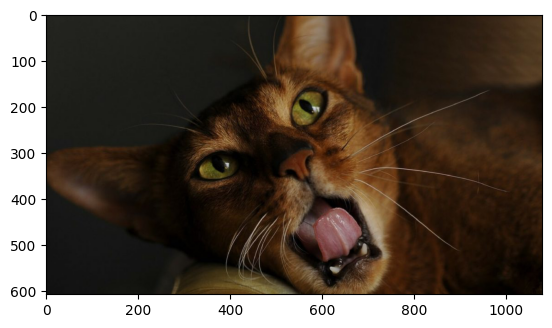

Prediction:  0    Class:  abyssinian


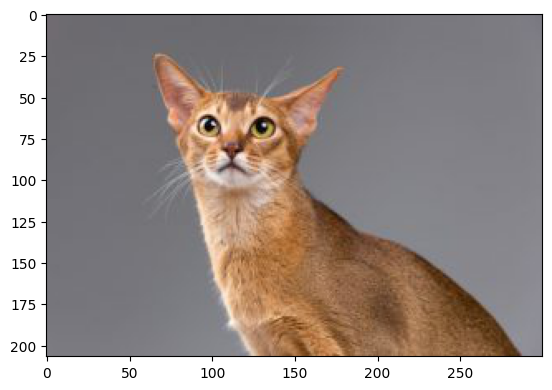

Prediction:  20    Class:  siamese cat


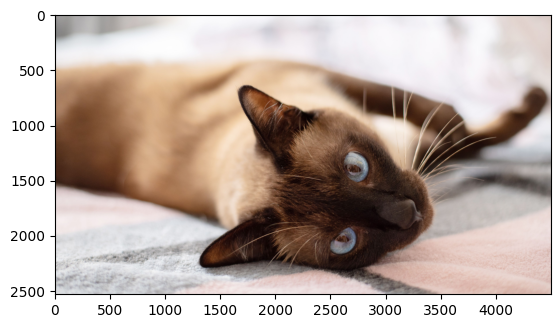

Prediction:  20    Class:  siamese cat


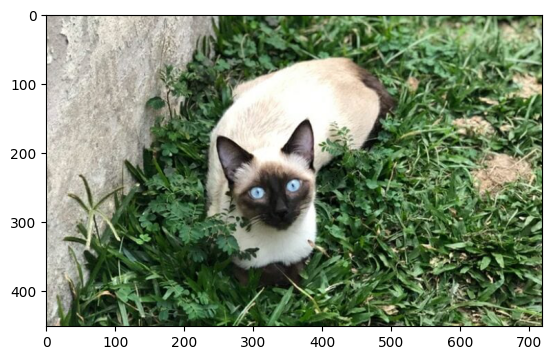

Prediction:  20    Class:  siamese cat


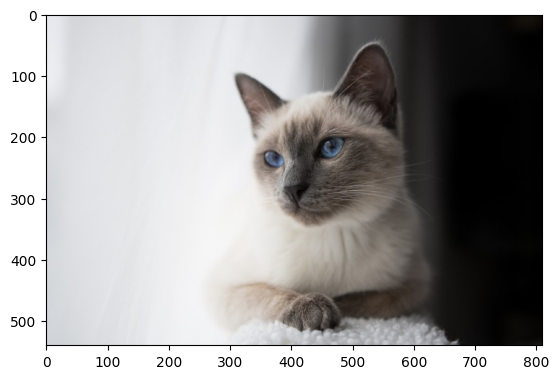

Prediction:  20    Class:  siamese cat


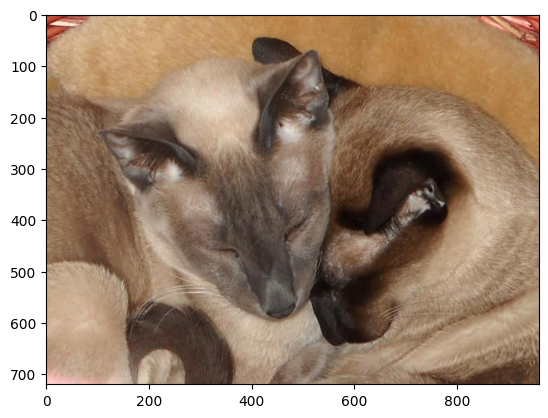

Prediction:  20    Class:  siamese cat


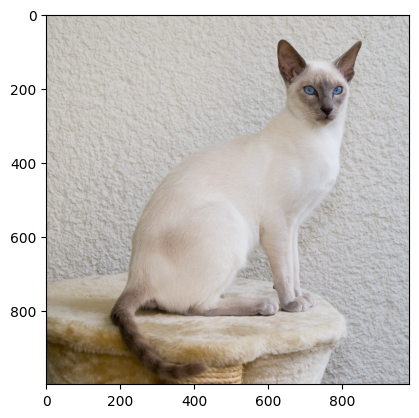

Prediction:  2    Class:  beagle


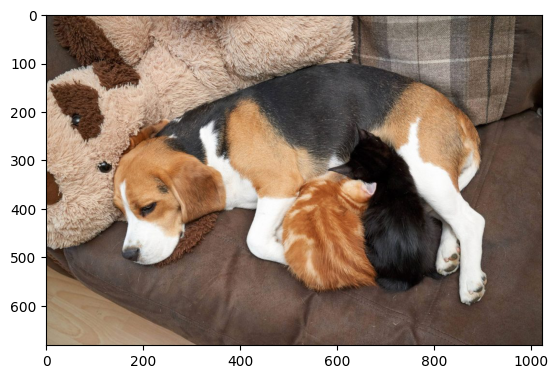

Prediction:  2    Class:  beagle


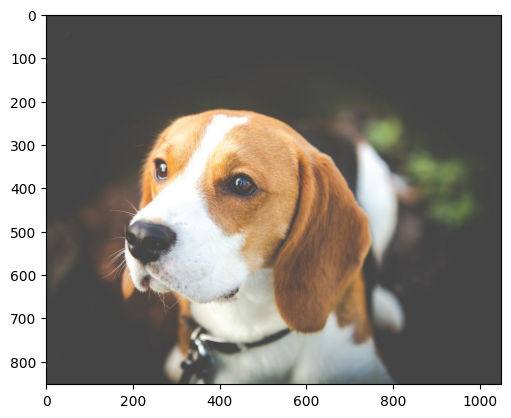

Prediction:  2    Class:  beagle


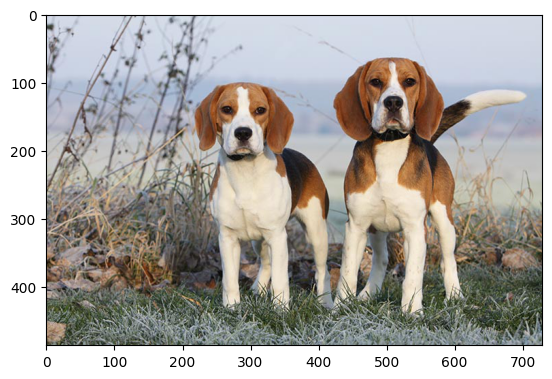

Prediction:  2    Class:  beagle


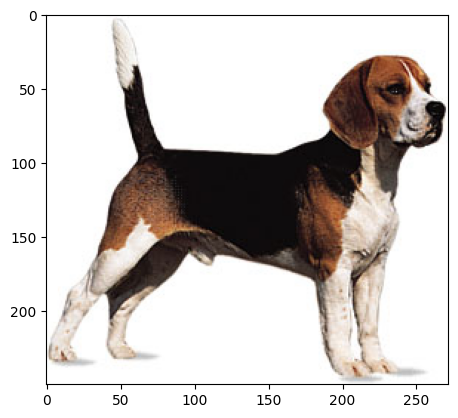

Prediction:  2    Class:  beagle


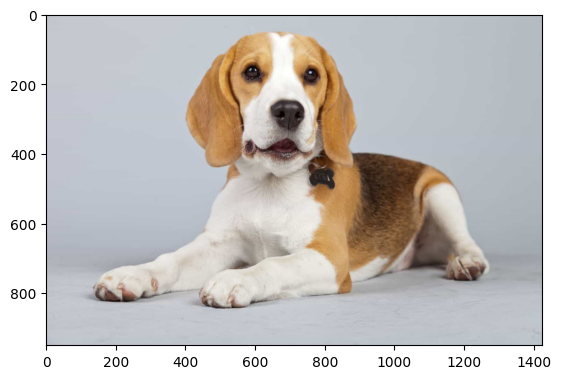

Prediction:  6    Class:  corgi


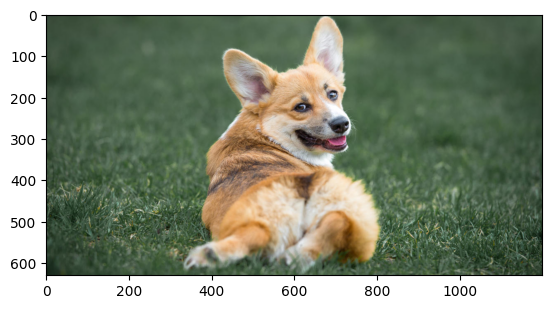

Prediction:  6    Class:  corgi


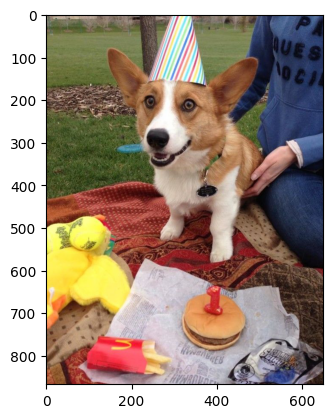

Prediction:  6    Class:  corgi


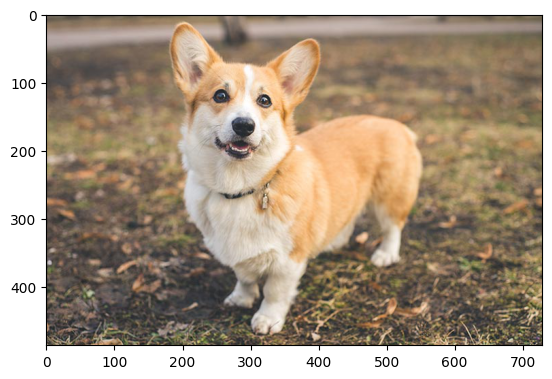

Prediction:  6    Class:  corgi


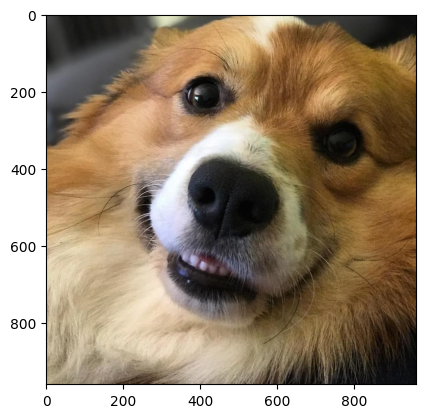

Prediction:  6    Class:  corgi


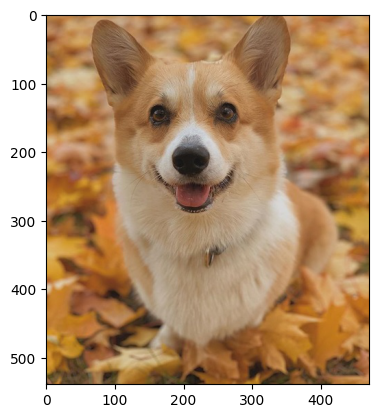

Prediction:  5    Class:  chihuahua


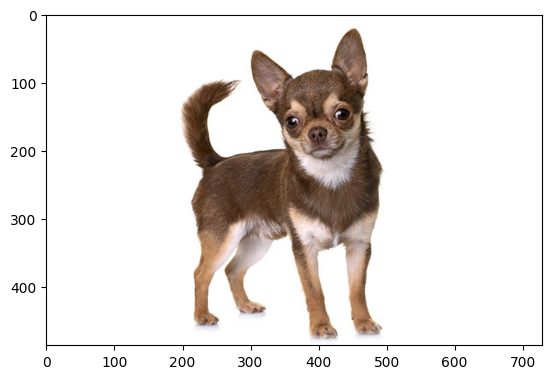

Prediction:  5    Class:  chihuahua


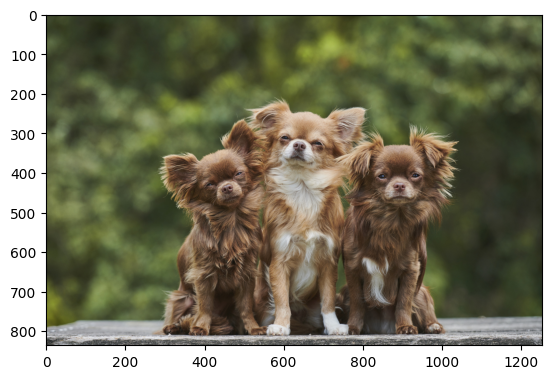

Prediction:  14    Class:  persian cat


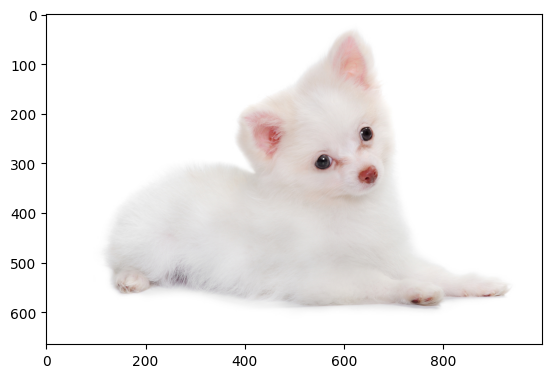

Prediction:  5    Class:  chihuahua


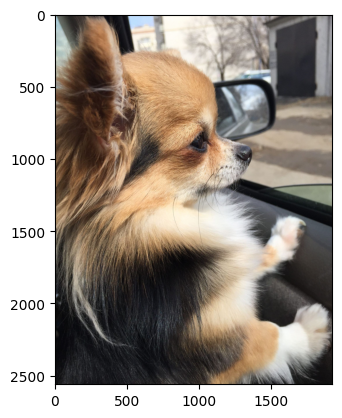

Prediction:  5    Class:  chihuahua


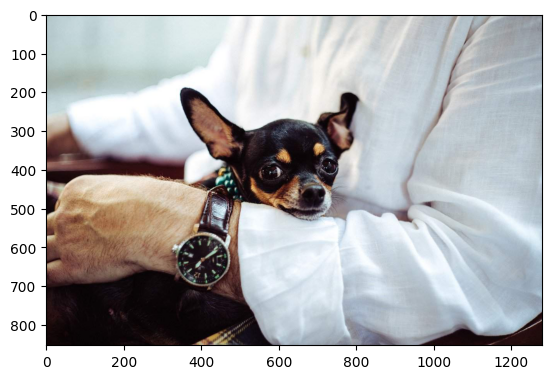

Prediction:  1    Class:  american shorthair


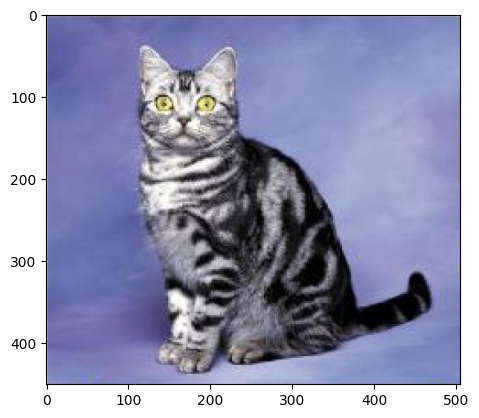

Prediction:  1    Class:  american shorthair


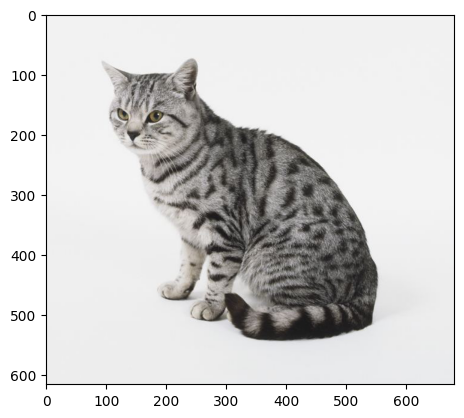

Prediction:  1    Class:  american shorthair


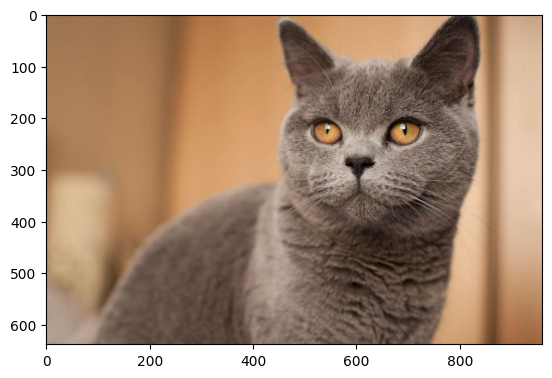

Prediction:  1    Class:  american shorthair


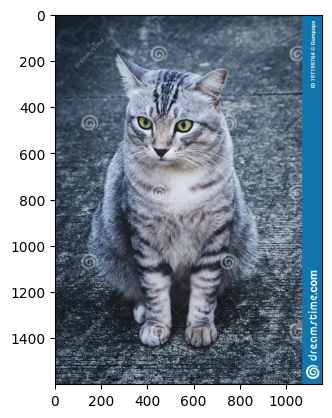

Prediction:  1    Class:  american shorthair


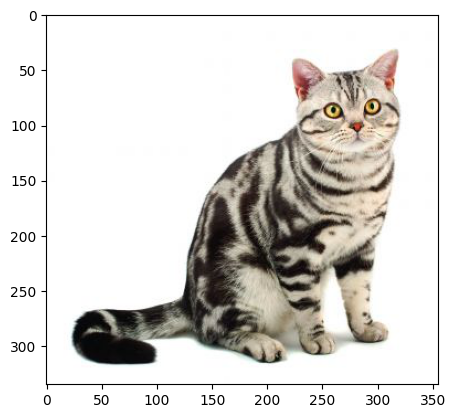

Prediction:  11    Class:  labrador


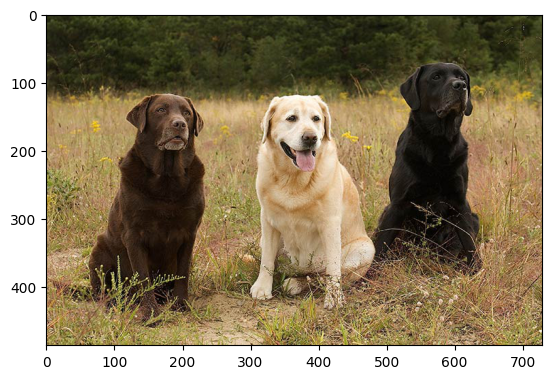

Prediction:  11    Class:  labrador


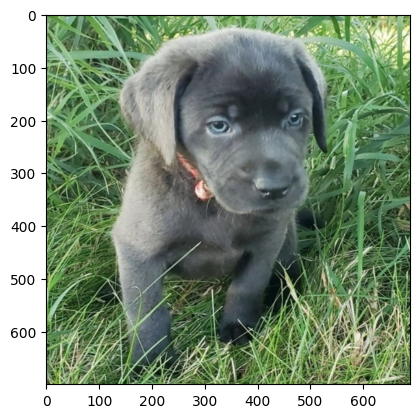

Prediction:  11    Class:  labrador


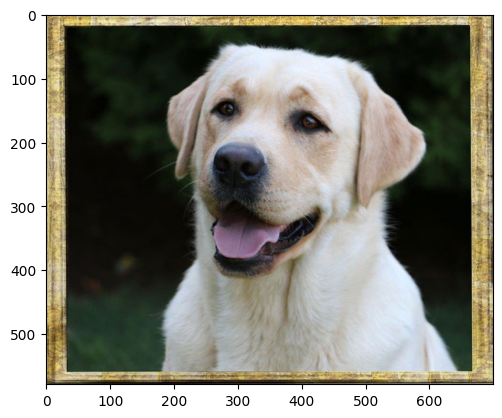

Prediction:  11    Class:  labrador


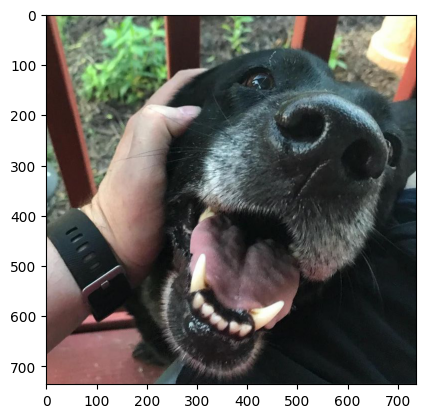

Prediction:  11    Class:  labrador


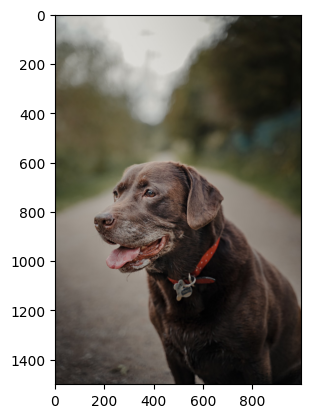

Prediction:  14    Class:  persian cat


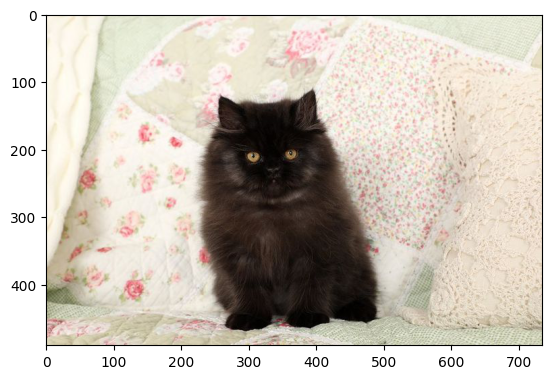

Prediction:  14    Class:  persian cat


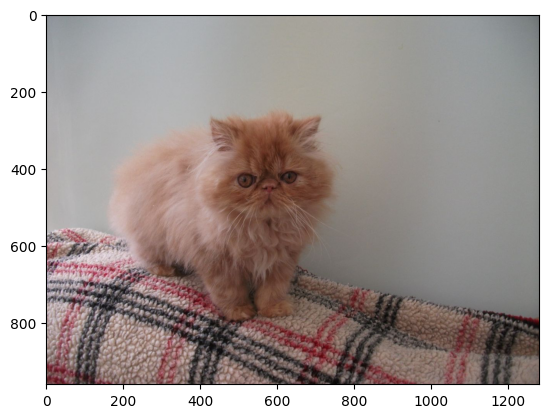

Prediction:  14    Class:  persian cat


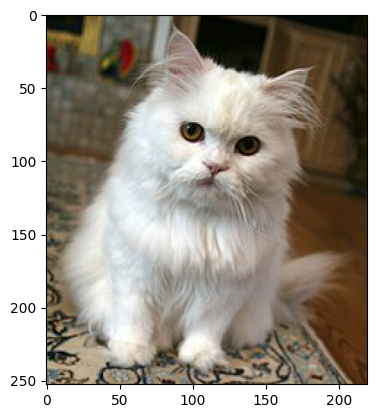

Prediction:  14    Class:  persian cat


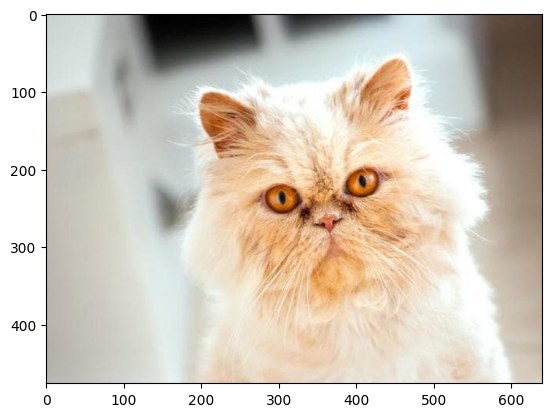

Prediction:  12    Class:  maine coon


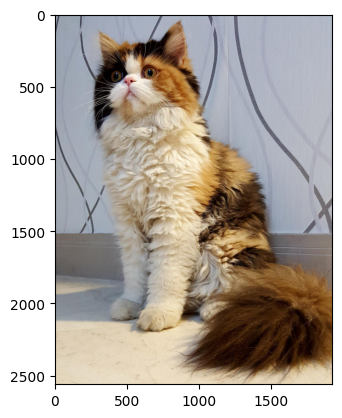

Prediction:  3    Class:  boxer


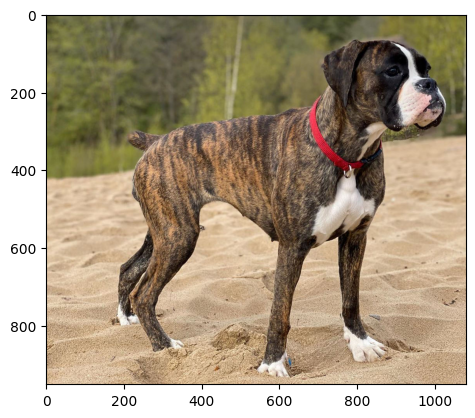

Prediction:  3    Class:  boxer


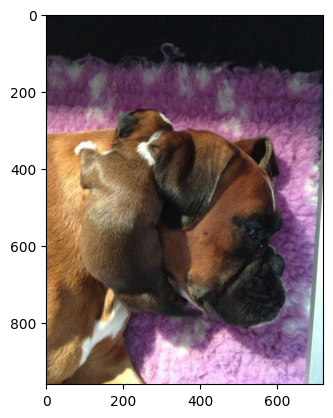

Prediction:  3    Class:  boxer


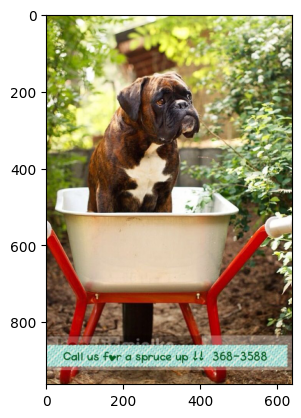

Prediction:  3    Class:  boxer


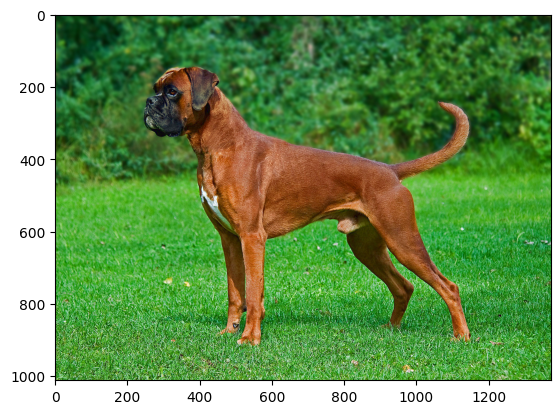

Prediction:  3    Class:  boxer


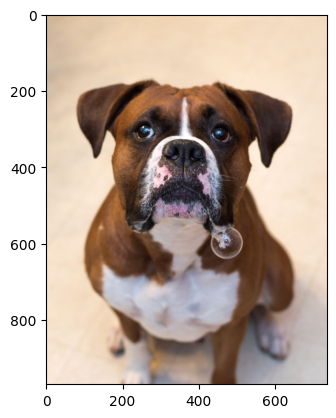

Prediction:  9    Class:  golden retriever


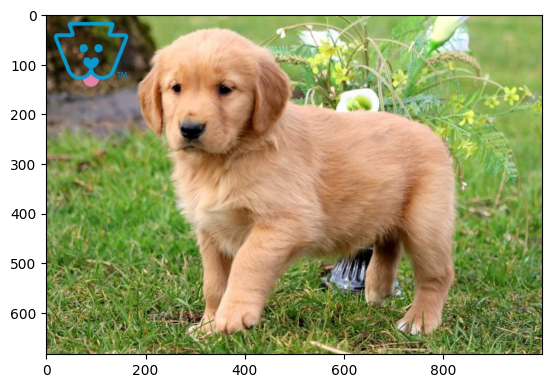

Prediction:  9    Class:  golden retriever


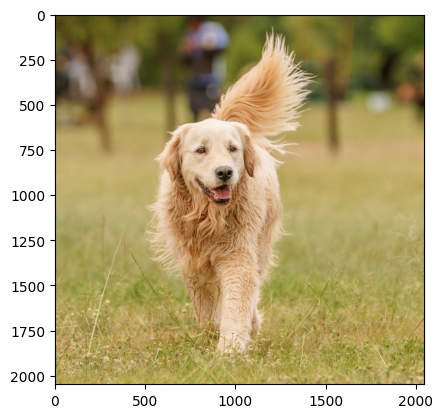

Prediction:  9    Class:  golden retriever


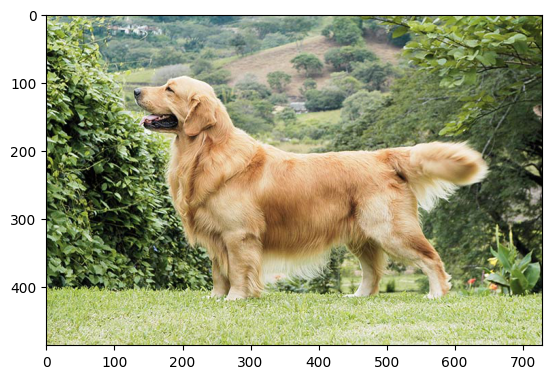

Prediction:  9    Class:  golden retriever


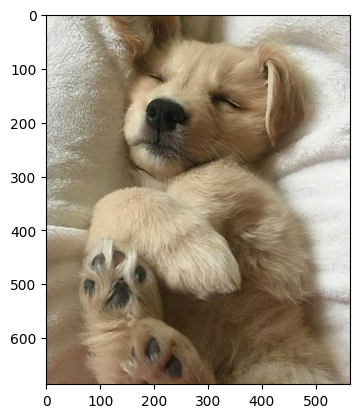

Prediction:  9    Class:  golden retriever


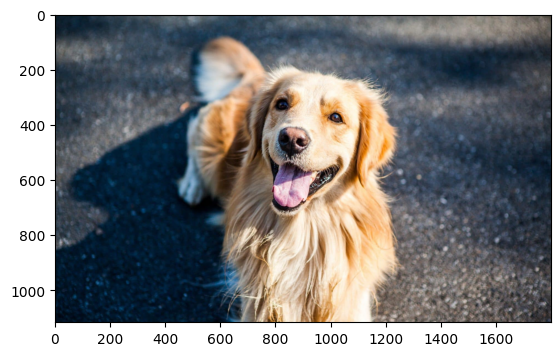

Prediction:  21    Class:  sphynx


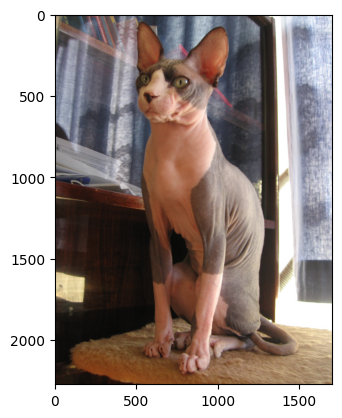

Prediction:  21    Class:  sphynx


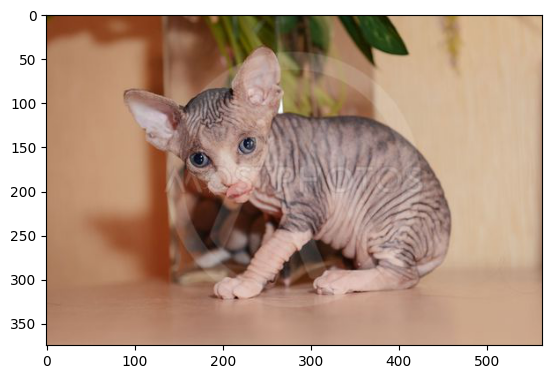

Prediction:  21    Class:  sphynx


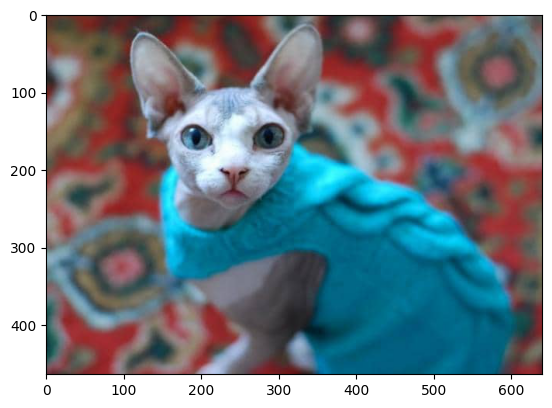

Prediction:  21    Class:  sphynx


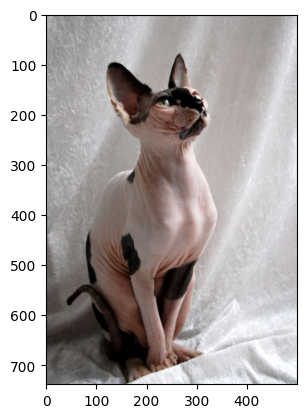

Prediction:  21    Class:  sphynx


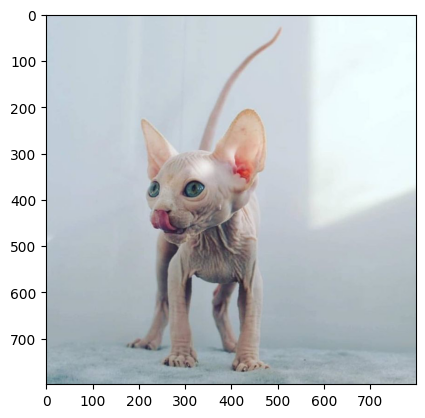

Prediction:  18    Class:  rottwiler


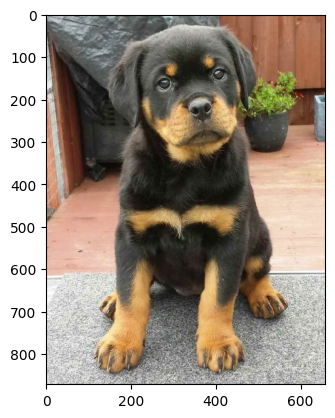

Prediction:  18    Class:  rottwiler


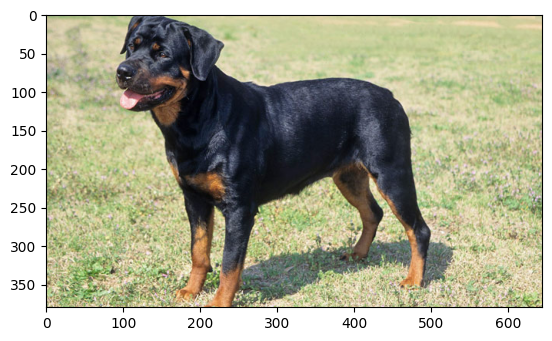

Prediction:  18    Class:  rottwiler


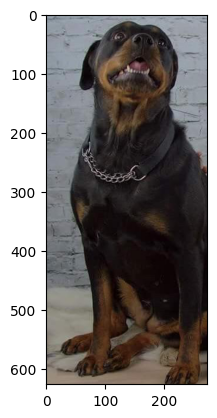

Prediction:  18    Class:  rottwiler


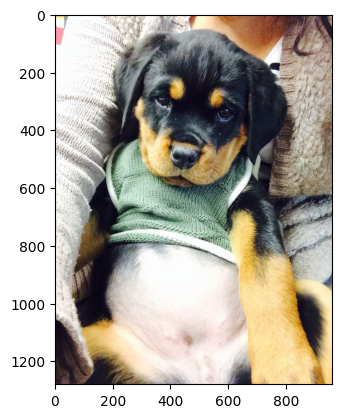

Prediction:  18    Class:  rottwiler


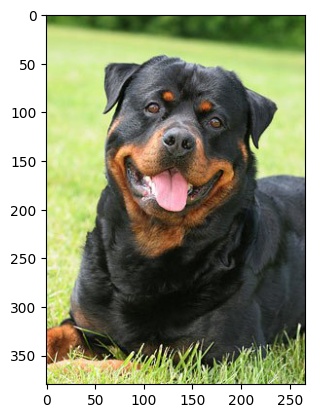

Prediction:  13    Class:  mumbai cat


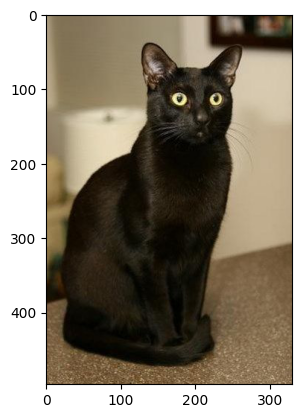

Prediction:  13    Class:  mumbai cat


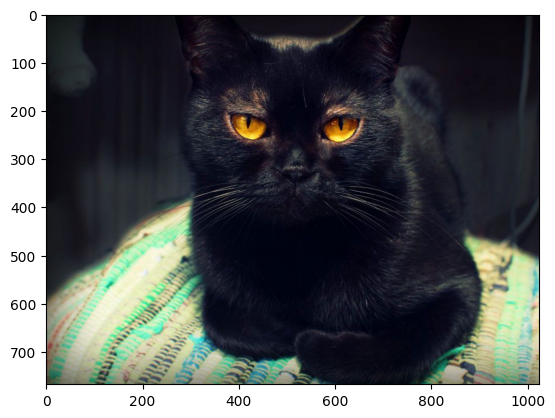

Prediction:  13    Class:  mumbai cat


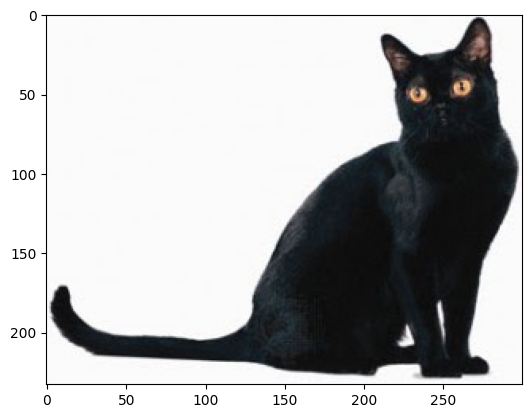

Prediction:  13    Class:  mumbai cat


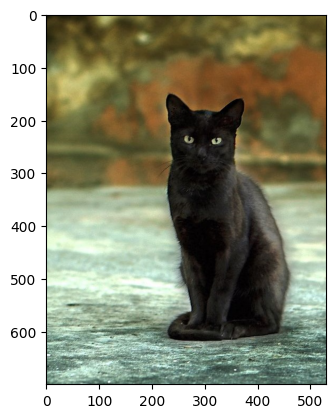

Prediction:  13    Class:  mumbai cat


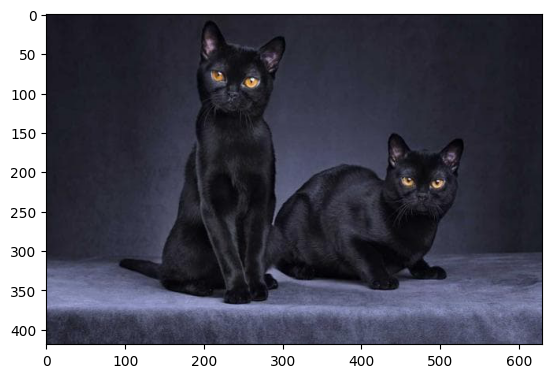

Prediction:  12    Class:  maine coon


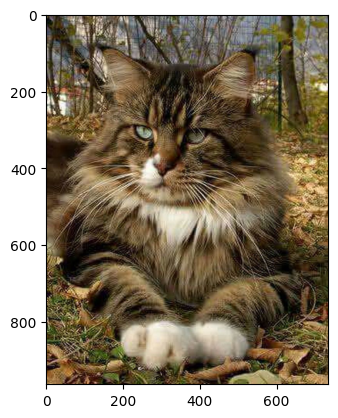

Prediction:  12    Class:  maine coon


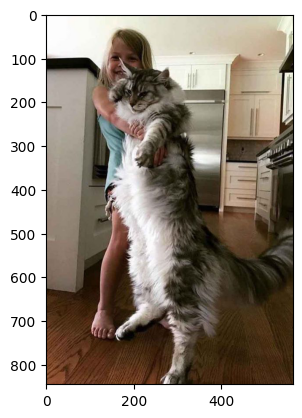

Prediction:  12    Class:  maine coon


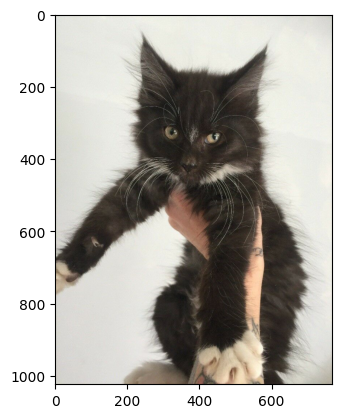

Prediction:  12    Class:  maine coon


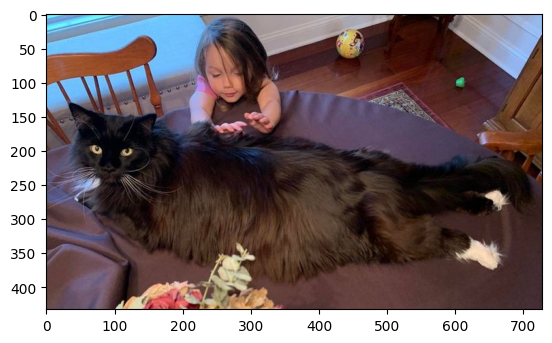

Prediction:  12    Class:  maine coon


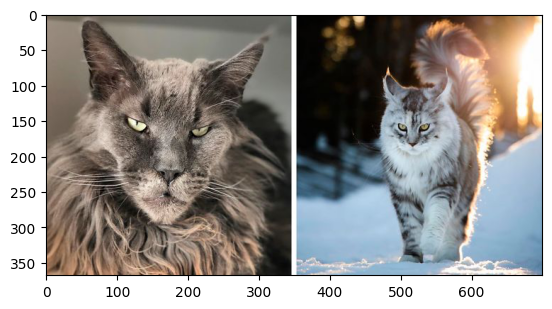

Prediction:  8    Class:  german shepherd


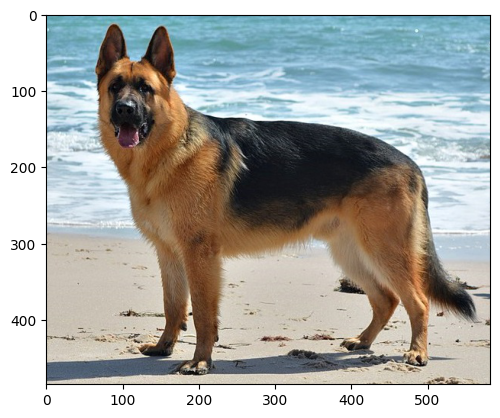

Prediction:  8    Class:  german shepherd


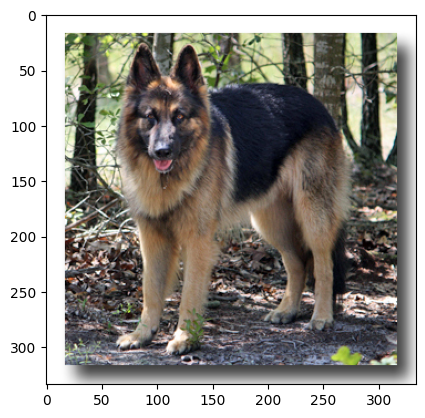

Prediction:  7    Class:  dachshund


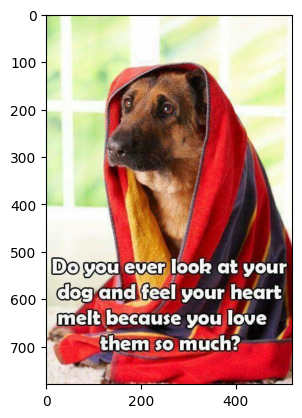

Prediction:  8    Class:  german shepherd


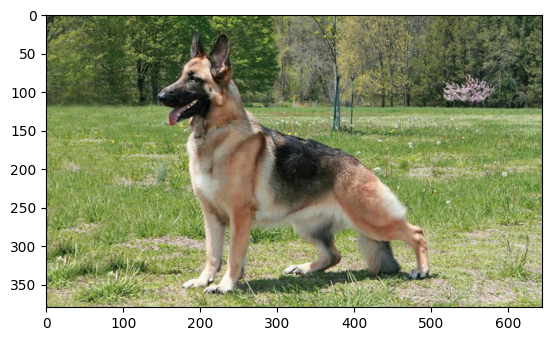

Prediction:  6    Class:  corgi


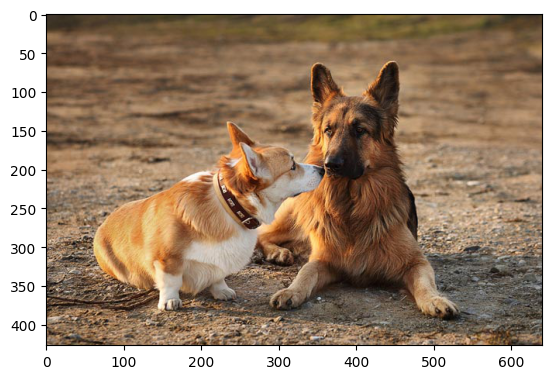

Prediction:  4    Class:  bulldog


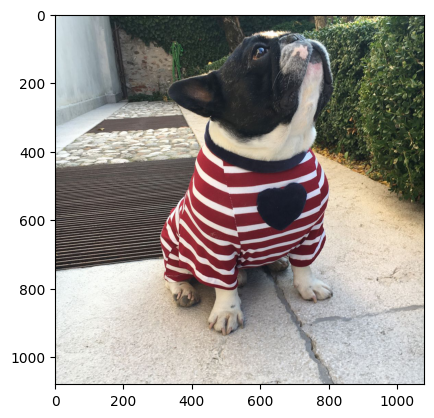

Prediction:  4    Class:  bulldog


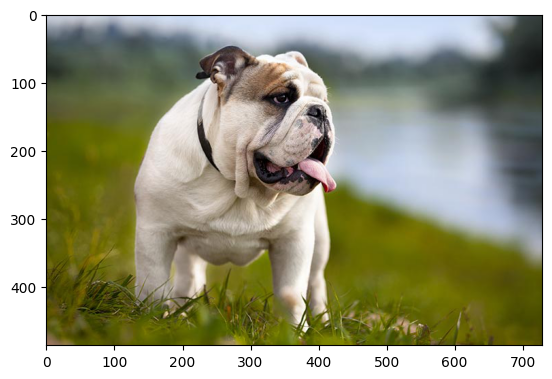

Prediction:  4    Class:  bulldog


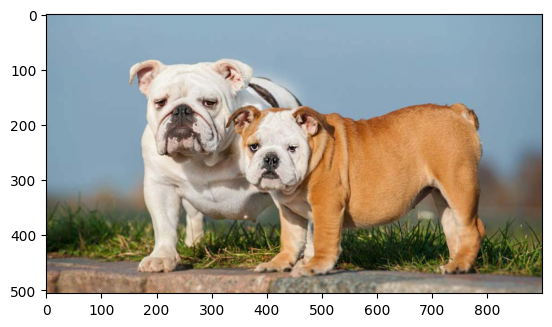

Prediction:  4    Class:  bulldog


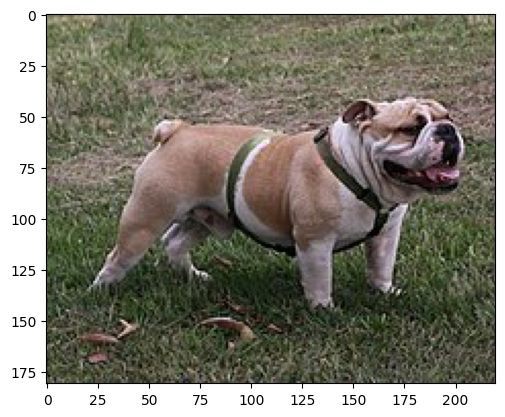

Prediction:  4    Class:  bulldog


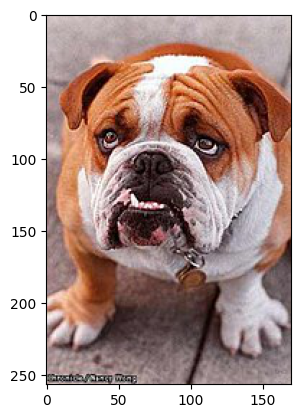

Prediction:  16    Class:  pug


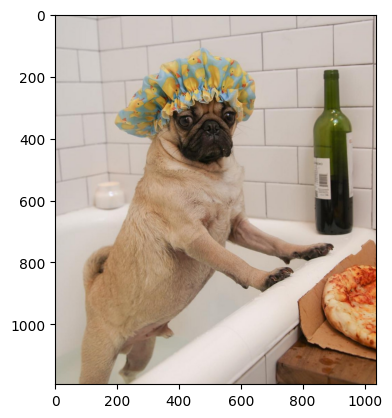

Prediction:  16    Class:  pug


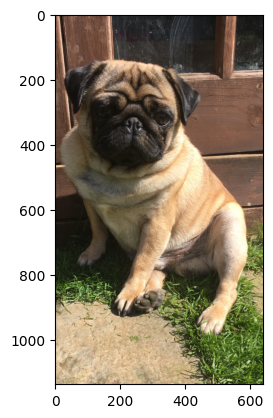

Prediction:  16    Class:  pug


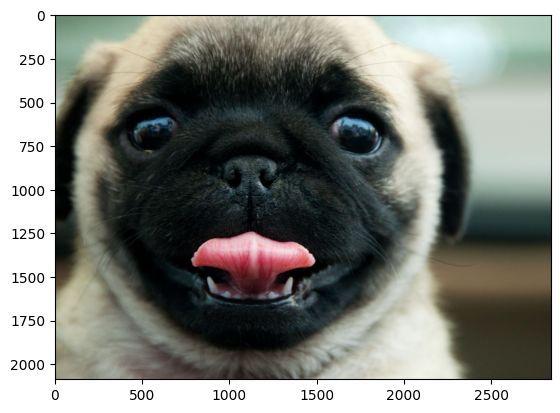

Prediction:  16    Class:  pug


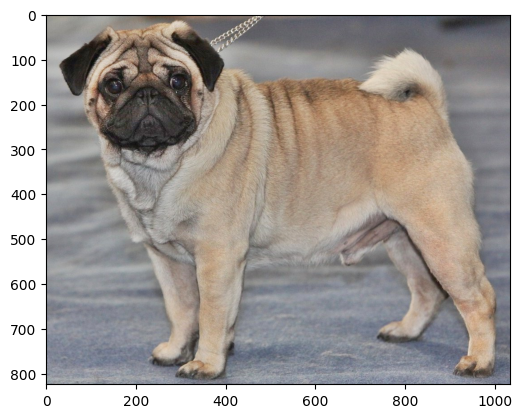

Prediction:  16    Class:  pug


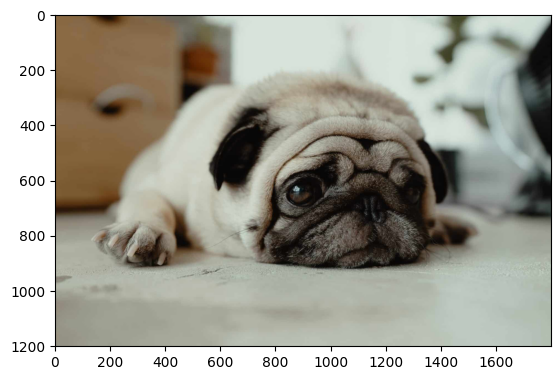

Prediction:  10    Class:  husky


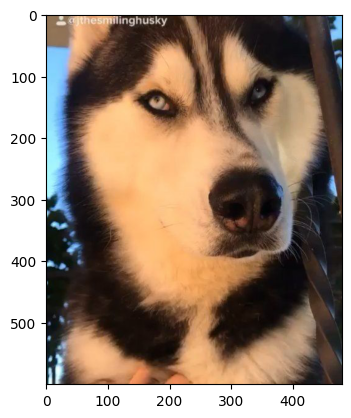

Prediction:  10    Class:  husky


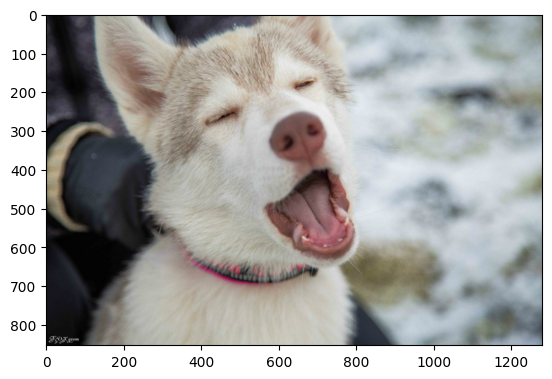

Prediction:  10    Class:  husky


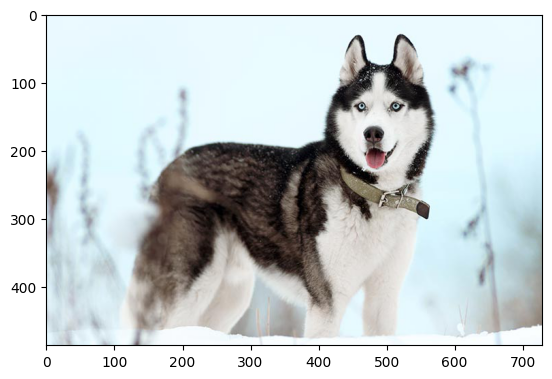

Prediction:  10    Class:  husky


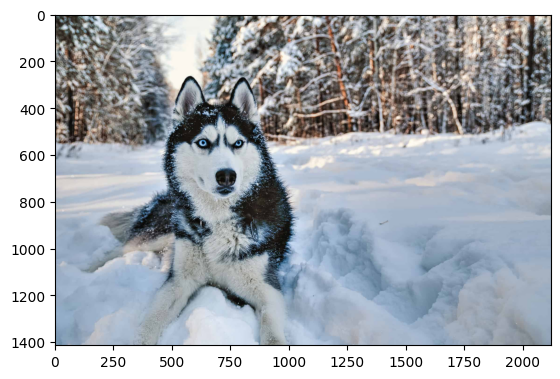

Prediction:  10    Class:  husky


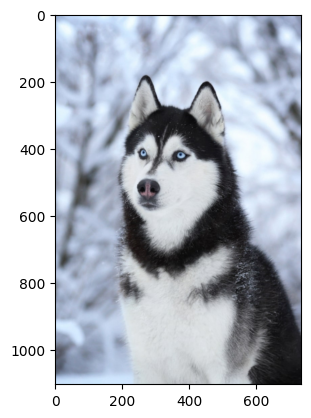

Prediction:  7    Class:  dachshund


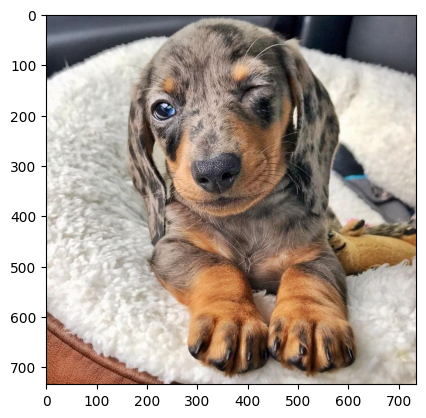

Prediction:  7    Class:  dachshund


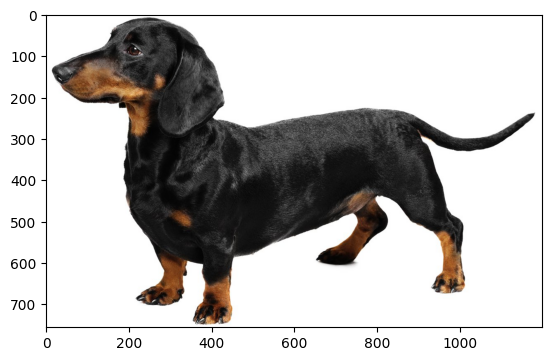

Prediction:  7    Class:  dachshund


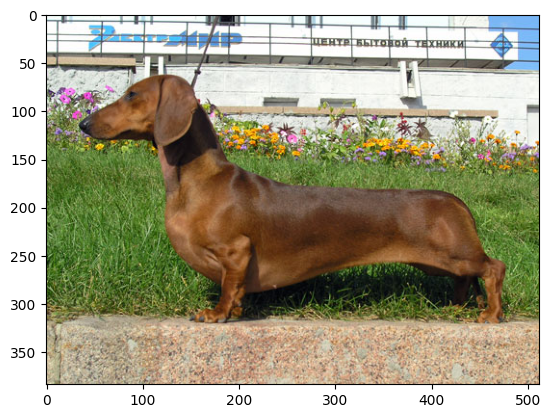

Prediction:  7    Class:  dachshund


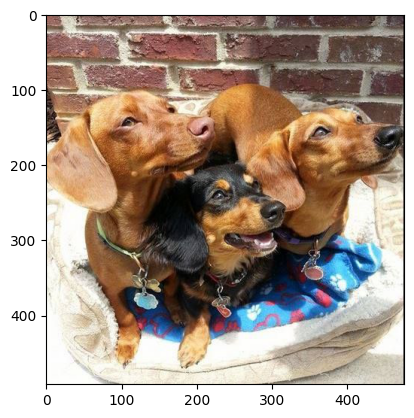

Prediction:  9    Class:  golden retriever


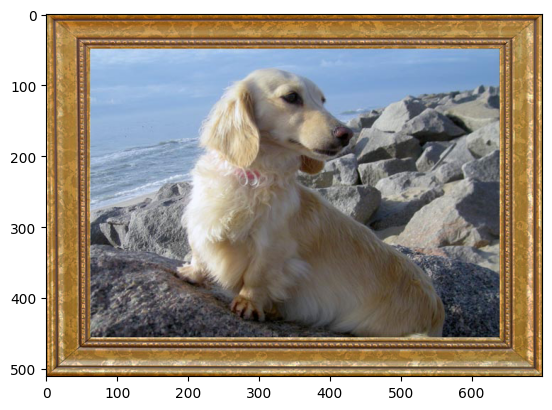

In [16]:
preds = []
for image in images:
    
  img = image_loader(image)
  pred = (model(img)).data.cpu().numpy().argmax()
  preds.append(pred)    
  print('Prediction: ', pred, '  ','Class: ', classes[pred])

    
  imshow(image)  
  plt.show()